<a href="https://colab.research.google.com/github/LIONHOOD/ExplainableAI/blob/main/XAI_CAMs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# OxfordIIITPet 데이터

In [ ]:
import torch
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import OxfordIIITPet
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

num_epochs = 10
batch_size = 128

# OxfordIIITPet
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
])

trainset = OxfordIIITPet(root='./', split='trainval', download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True, num_workers=2)
testset = OxfordIIITPet(root='./', split='test', download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size, shuffle=False, num_workers=2)

In [ ]:
len(trainset), len(testset)

(3680, 3669)

In [ ]:
print(trainset.classes)

['Abyssinian', 'American Bulldog', 'American Pit Bull Terrier', 'Basset Hound', 'Beagle', 'Bengal', 'Birman', 'Bombay', 'Boxer', 'British Shorthair', 'Chihuahua', 'Egyptian Mau', 'English Cocker Spaniel', 'English Setter', 'German Shorthaired', 'Great Pyrenees', 'Havanese', 'Japanese Chin', 'Keeshond', 'Leonberger', 'Maine Coon', 'Miniature Pinscher', 'Newfoundland', 'Persian', 'Pomeranian', 'Pug', 'Ragdoll', 'Russian Blue', 'Saint Bernard', 'Samoyed', 'Scottish Terrier', 'Shiba Inu', 'Siamese', 'Sphynx', 'Staffordshire Bull Terrier', 'Wheaten Terrier', 'Yorkshire Terrier']


In [ ]:
trainset[0][0].shape

torch.Size([3, 224, 224])

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
def imshow(img):
    img = img / 2 + 0.5 # unnormalize
    npimg = img.numpy()
    plt.figure(figsize=(16,16))
    plt.axis('off')
    plt.imshow(np.transpose(npimg, (1,2,0)));

viz_size = 64
vizloader = torch.utils.data.DataLoader(trainset, batch_size=viz_size, shuffle=True, num_workers=2)
dataiter = iter(vizloader)


Wheaten Terrier||Ragdoll||Basset Hound||English Setter||Boxer||Chihuahua||Saint Bernard||Wheaten Terrier||
German Shorthaired||Samoyed||Boxer||Saint Bernard||Leonberger||Pug||American Bulldog||German Shorthaired||
Leonberger||Abyssinian||Pug||Russian Blue||Abyssinian||Keeshond||Newfoundland||German Shorthaired||
Russian Blue||Shiba Inu||English Setter||Miniature Pinscher||Abyssinian||Pug||Saint Bernard||Pug||
Saint Bernard||Leonberger||Abyssinian||Abyssinian||Havanese||Keeshond||Staffordshire Bull Terrier||Japanese Chin||
Staffordshire Bull Terrier||Persian||Siamese||Leonberger||Birman||Miniature Pinscher||Japanese Chin||Staffordshire Bull Terrier||
Maine Coon||American Bulldog||Bombay||Pug||Bombay||Egyptian Mau||Russian Blue||Great Pyrenees||
Bombay||Birman||English Setter||Siamese||Wheaten Terrier||American Bulldog||Bombay||Keeshond


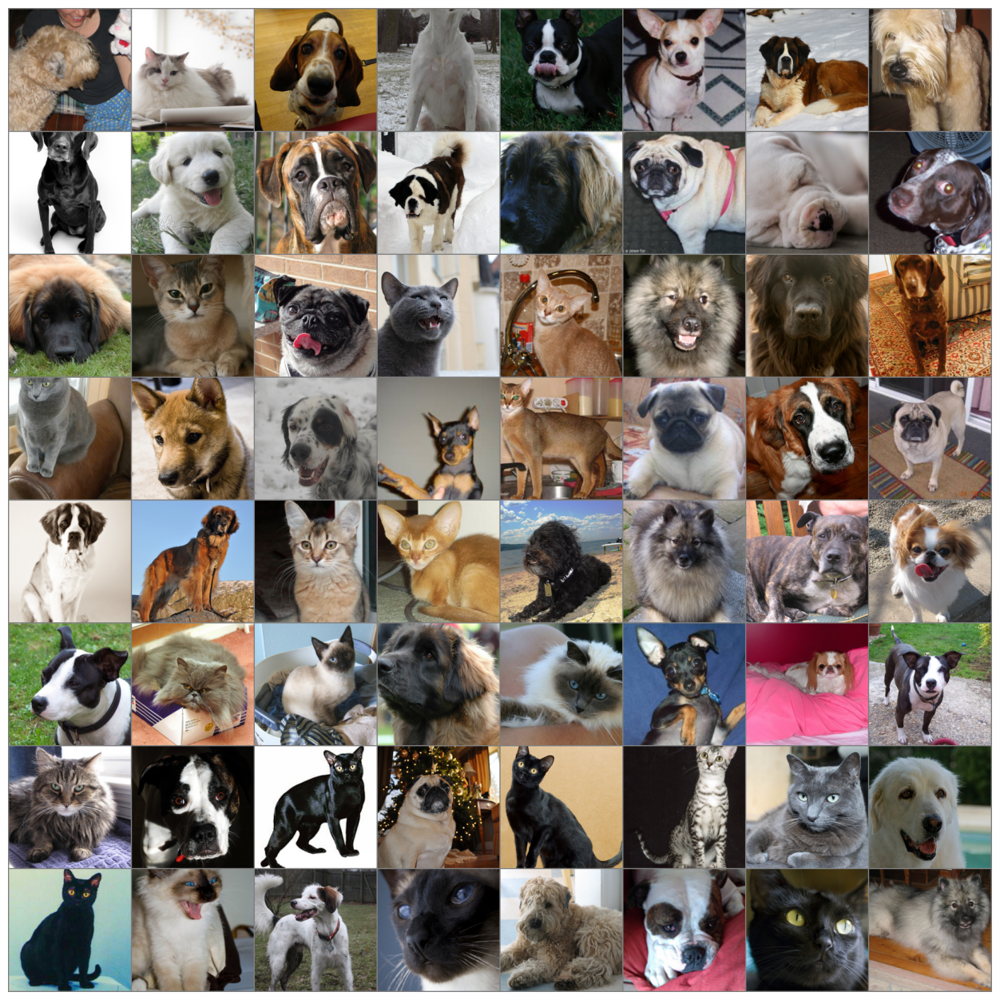

In [ ]:
images, labels = next(dataiter)
imshow(torchvision.utils.make_grid(images))
print('||'.join([f'\n{trainset.classes[labels[j]]}', f'{trainset.classes[labels[j]]}'][bool(j%8 and j!=0)] for j in range(viz_size)))

# Visual Explanation for CNN
데이터에 내재된 공간적 특징 포착 여부에 대한 해석 및 시각화

## [**Class Activation Map (CAM)**](https://arxiv.org/pdf/1512.04150.pdf)

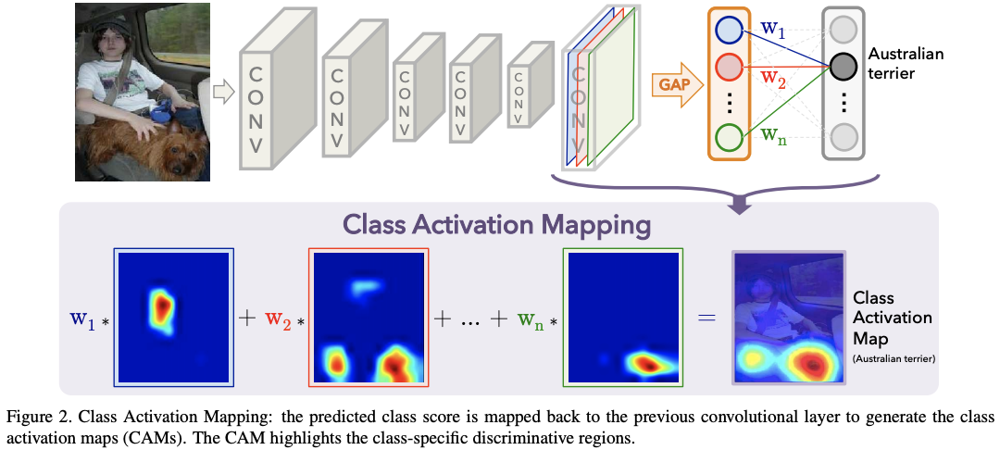

모델 구조 가정 : CNN-based model의 구조는 feature extraction (N Conv Layers) + <ins>classification (1 FC Layer)
- <ins>보존된 공간 정보
- flatten 및 N-th feature map (N-th Conv Layer의 output)의 분류 복잡도에 대한 제약

> (참고) 일반적 구조
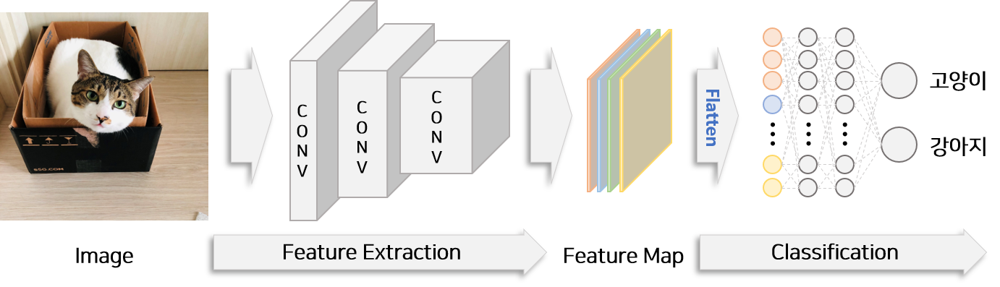

**Global Average Pooling (GAP)** : N-th feature map의 채널(1~n)별 요약 통계량 추출
- CAM의 구현을 위한 모델 (재)구성 단계 중 flatten의 대체
- k-th 채널의 요약 통계량
>$F_k=\sum_{x,y}f_k(x,y)$ (단, $f_k(x,y)$는 N-th feature map의 k-th 채널에서 $(x,y)$ 성분)
- FC Layer 가중치 $w_k^c$ : 클래스 c에 대한 $F_k$의 기여도
 - 회귀계수
 - *feature map attribution*
- 모델 output : 클래스별 분류 확률
>$P=(p_1,...,p_M)\in S_{M-1},\quad p_c=\cfrac{exp(\sum_{k=1}^{n}w_k^cF_k)}{\sum_{c=1}^{M}exp(\sum_{k=1}^{n}w_k^cF_k)}$

**Activation Value** : spatial feature attribution
- 클래스별 pixel attribution의 근사 유도
>$\sum_kw_k^cF_k=\sum_kw_k^c\sum_{x,y}f_k(x,y)=\sum_{x,y}\sum_kw_k^cf_k(x,y)=\sum_{x,y}AV_c(x,y)$  
$\Longrightarrow AV_c(x,y)=\sum_kw_k^cf_k(x,y)\quad(1≤c≤M)$

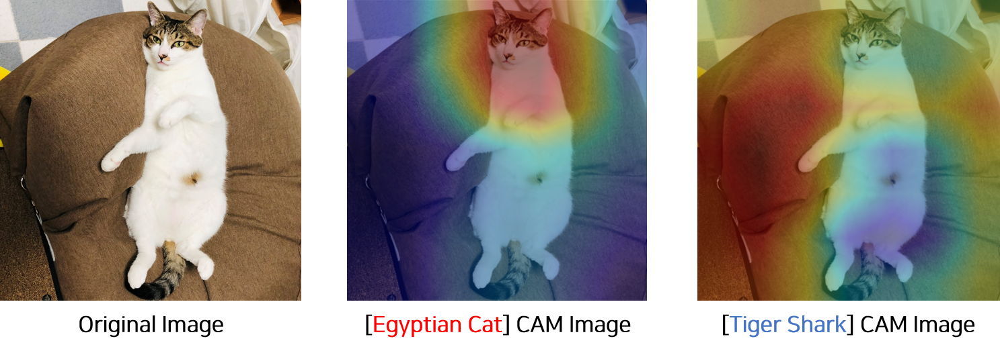

**Limitation**
- 모델 구조의 제약
 - ResNet 구조는 원형 보존 가능
 - AlexNet, VGGNet, GoogLeNet 등의 구조는 변경하여 적용

>[ResNet 구조 예시](https://github.com/pytorch/vision/blob/master/torchvision/models/resnet.py)

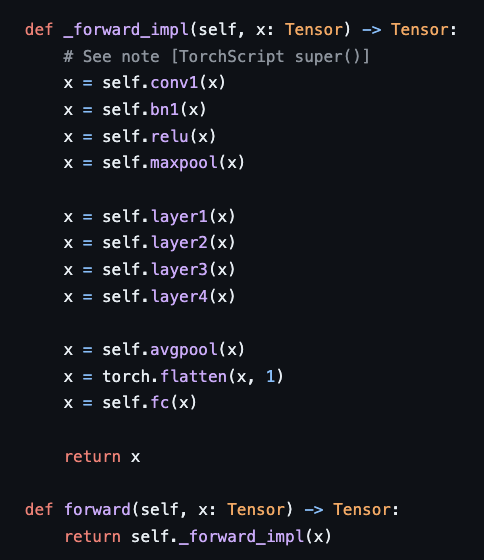

※ **WSOL** (Weakly Supervised Object Localization)
- 특정 클래스로 분류 = 해당 클래스에서 CAM Image 내 객체가 가장 뚜렷하게 식별 <ins>(classification with localization)
- localization (위치 식별) 성능 : GAP > GMP (Global Max Pooling)
 - GAP : 전체적으로 뚜렷한 특징에 초점
 - GMP : 하나의 뚜렷한 특징에 초점

### 실습 코드

In [ ]:
import os
import numpy as np
# 파일 형식 제한
pet = os.listdir('/content/oxford-iiit-pet/images')
for x in pet:
    if not x.endswith('.jpg'):
        pet.remove(x)
print(len(pet))
pet[np.random.randint(0, len(pet))]

7390


'great_pyrenees_56.jpg'

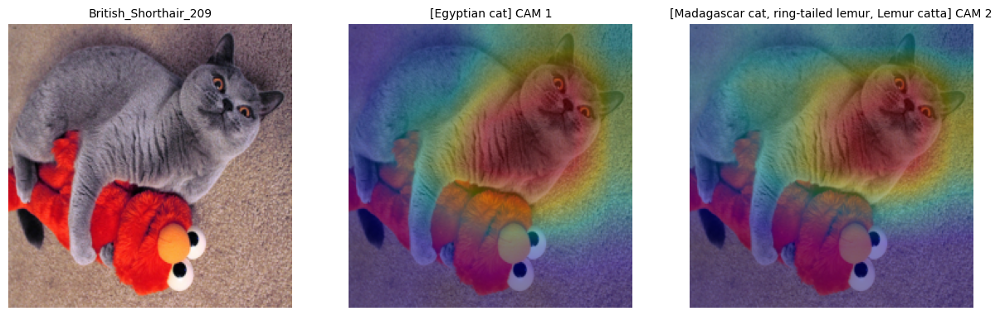

In [ ]:
import torch
from torchvision import datasets, models, transforms
import torch.nn.functional as F
from PIL import Image
from matplotlib import pyplot as plt
import urllib.request
import ast
import numpy as np
import cv2

# class of ImageNet for pretrained ResNet
class_url = 'https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt'
with urllib.request.urlopen(class_url) as handler:
    data = handler.read().decode()
    classes = ast.literal_eval(data)

# ResNet
model = models.resnet18(weights='DEFAULT')
model.eval()

# 전처리 정보 : ImageNet transform
# https://github.com/pytorch/examples/blob/42e5b996718797e45c46a25c55b031e6768f8440/imagenet/main.py#L89-L101
# 1. 예측 전처리
preprocess1 = transforms.Compose([
    # transforms.Resize(256), # 비율 맞춰서 이미지 규격 조정 ; 긴 모서리가 남을 수 있음 ; 비율 왜곡으로 인한 성능 저하를 더 예방 ; 예측에 사용할 이미지에 따라 적절히 다른 처리 필요
    # transforms.CenterCrop(224), # 중심 기준 정방형
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
# 2. 시각화 전처리 ; ToTensor, Normalize 제외
preprocess2 = transforms.Compose([
    # transforms.Resize(256),
    # transforms.CenterCrop(224)
    transforms.Resize((224,224))
])

# load and preprocess a sample image
img_path = '/content/oxford-iiit-pet/images/British_Shorthair_209.jpg'
# img_path = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))]
raw_img = Image.open(img_path)
img_input = preprocess1(raw_img)

# 모델 출력
output = model(img_input.unsqueeze(0)) # shape의 0번 인덱스에 1인 차원 생성

# 클래스 추출
probs = F.softmax(output, dim=1)
# class_idx = int(probs.argmax().numpy())
class_idx, class_idx2 = map(int, (-probs).argsort()[0][:2]) # top-2

# ResNet 구조 참고 : avgpool 직전까지 feature extraction
def feature_extraction(self, x):
    x = self.conv1(x)
    x = self.bn1(x)
    x = self.relu(x)
    x = self.maxpool(x)

    x = self.layer1(x)
    x = self.layer2(x)
    x = self.layer3(x)
    x = self.layer4(x)

    return x

# feature maps
feature_maps = feature_extraction(model, img_input.unsqueeze(0)).squeeze().detach().numpy()

# weights of FC Layer
activation_weights = list(model.parameters())[-2].data.numpy()

# numpy array로 이미지 변환
numpy_img = np.asarray(preprocess2(raw_img)) # numpy_img : (H, W)

# CAM 시각화
def show_CAM(img_path, numpy_img, feature_maps, activation_weights, classes, class_idx, class_idx2):
    # 시각화 구현을 위한 Activation Value 전달은 np.matmul 사용

    # top-1
    cam_img = np.matmul(activation_weights[class_idx], # activation_weights[class_idx] : (512)
                        feature_maps.reshape(feature_maps.shape[0], -1)).reshape(feature_maps.shape[1:])
                        # feature_maps : (512, feat_h, feat_w)
            # cam_img : (feat_h, feat_w)
    # 정규화
    cam_img = cam_img - np.min(cam_img)
    cam_img = cam_img / np.max(cam_img)
    cam_img = np.uint8(255 * cam_img)
    # heatmap으로 변환 ; 원본 이미지 위에 덮는 것을 고려 ; cv2.resize 입력 순서는 (가로 W, 세로 H)
    heatmap = cv2.applyColorMap(cv2.resize(255-cam_img, (numpy_img.shape[1], numpy_img.shape[0])), cv2.COLORMAP_JET)
    # 이미지 배열 연산으로 heatmap을 덮은 이미지 구현
    result = numpy_img*0.5 + heatmap*0.3
    result = np.uint8(result)

    # top-2
    cam_img2 = np.matmul(activation_weights[class_idx2], feature_maps.reshape(feature_maps.shape[0], -1)).reshape(feature_maps.shape[1:])
    cam_img2 = cam_img2 - np.min(cam_img2)
    cam_img2 = cam_img2 / np.max(cam_img2)
    cam_img2 = np.uint8(255 * cam_img2)
    heatmap2 = cv2.applyColorMap(cv2.resize(255-cam_img2, (numpy_img.shape[1], numpy_img.shape[0])), cv2.COLORMAP_JET)
    result2 = numpy_img*0.5 + heatmap2*0.3
    result2 = np.uint8(result2)

    # 시각화
    fig = plt.figure(figsize=(15, 5))
    # 원본 이미지
    ax1 = fig.add_subplot(1, 3, 1)
    ax1.imshow(numpy_img)
    ax1.set_title(img_path[32:-4], fontsize=10)
    ax1.axis('off')
    # CAM 이미지 top-1
    ax2 = fig.add_subplot(1, 3, 2)
    ax2.imshow(result)
    ax2.set_title(f"[{classes[class_idx]}] CAM 1", fontsize=10)
    ax2.axis('off')
    # CAM 이미지 top-2
    ax3 = fig.add_subplot(1, 3, 3)
    ax3.imshow(result2)
    ax3.set_title(f"[{classes[class_idx2]}] CAM 2", fontsize=10)
    ax3.axis('off')

    plt.show()

show_CAM(img_path, numpy_img, feature_maps, activation_weights, classes, class_idx, class_idx2)

#### 예시 1

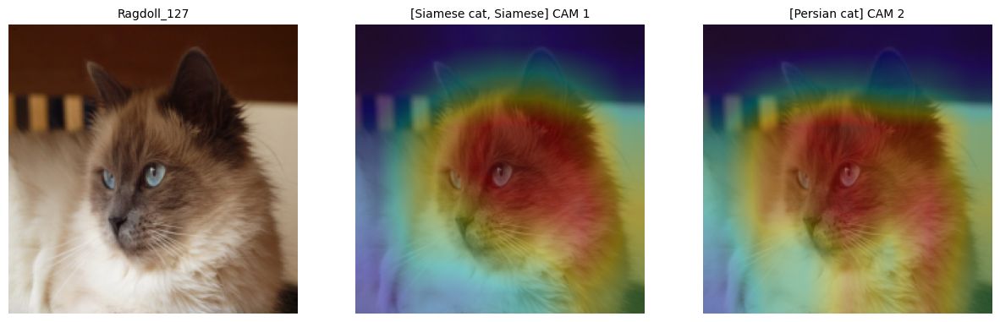

In [ ]:
# load and preprocess a sample image
img_path1 = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))]
raw_img = Image.open(img_path1)
img_input = preprocess1(raw_img)

# 모델 출력
output = model(img_input.unsqueeze(0)) # shape의 0번 인덱스에 1인 차원 생성

# 클래스 추출
probs = F.softmax(output, dim=1)
# class_idx = int(probs.argmax().numpy())
class_idx, class_idx2 = map(int, (-probs).argsort()[0][:2]) # top-2

# feature maps
feature_maps = feature_extraction(model, img_input.unsqueeze(0)).squeeze().detach().numpy()

# weights of FC Layer
activation_weights = list(model.parameters())[-2].data.numpy()

# numpy array로 이미지 변환
numpy_img = np.asarray(preprocess2(raw_img))

# CAM 시각화
show_CAM(img_path1, numpy_img, feature_maps, activation_weights, classes, class_idx, class_idx2)

#### 예시 2

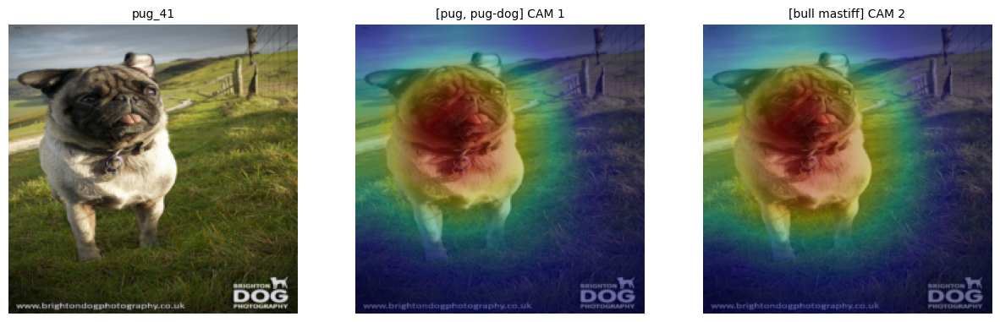

In [ ]:
# load and preprocess a sample image
img_path2 = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))]
raw_img = Image.open(img_path2)
img_input = preprocess1(raw_img)

# 모델 출력
output = model(img_input.unsqueeze(0)) # shape의 0번 인덱스에 1인 차원 생성

# 클래스 추출
probs = F.softmax(output, dim=1)
# class_idx = int(probs.argmax().numpy())
class_idx, class_idx2 = map(int, (-probs).argsort()[0][:2]) # top-2

# feature maps
feature_maps = feature_extraction(model, img_input.unsqueeze(0)).squeeze().detach().numpy()

# weights of FC Layer
activation_weights = list(model.parameters())[-2].data.numpy()

# numpy array로 이미지 변환
numpy_img = np.asarray(preprocess2(raw_img))

# CAM 시각화
show_CAM(img_path2, numpy_img, feature_maps, activation_weights, classes, class_idx, class_idx2)

#### 예시 3

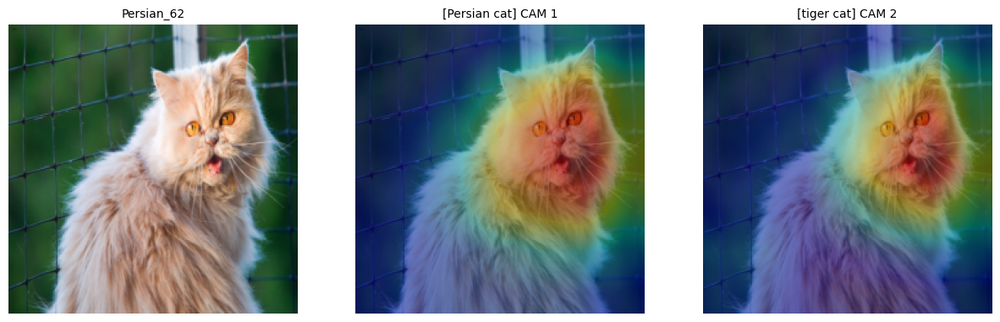

In [ ]:
# load and preprocess a sample image
img_path3 = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))]
raw_img = Image.open(img_path3)
img_input = preprocess1(raw_img)

# 모델 출력
output = model(img_input.unsqueeze(0)) # shape의 0번 인덱스에 1인 차원 생성

# 클래스 추출
probs = F.softmax(output, dim=1)
# class_idx = int(probs.argmax().numpy())
class_idx, class_idx2 = map(int, (-probs).argsort()[0][:2]) # top-2

# feature maps
feature_maps = feature_extraction(model, img_input.unsqueeze(0)).squeeze().detach().numpy()

# weights of FC Layer
activation_weights = list(model.parameters())[-2].data.numpy()

# numpy array로 이미지 변환
numpy_img = np.asarray(preprocess2(raw_img))

# CAM 시각화
show_CAM(img_path3, numpy_img, feature_maps, activation_weights, classes, class_idx, class_idx2)

#### 예시 4

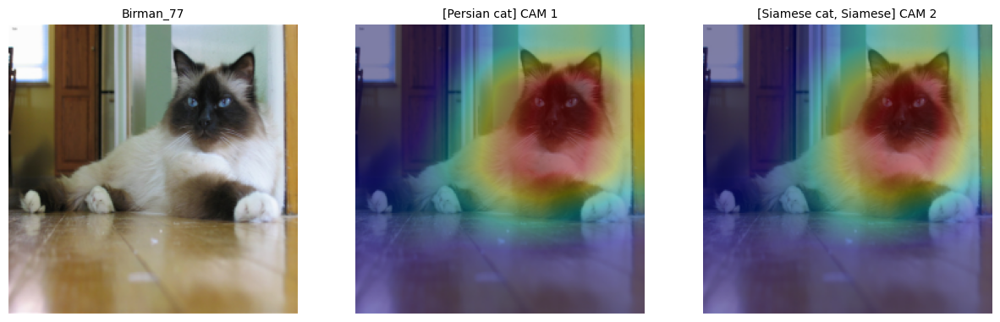

In [ ]:
# load and preprocess a sample image
img_path4 = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))]
raw_img = Image.open(img_path4)
img_input = preprocess1(raw_img)

# 모델 출력
output = model(img_input.unsqueeze(0)) # shape의 0번 인덱스에 1인 차원 생성

# 클래스 추출
probs = F.softmax(output, dim=1)
# class_idx = int(probs.argmax().numpy())
class_idx, class_idx2 = map(int, (-probs).argsort()[0][:2]) # top-2

# feature maps
feature_maps = feature_extraction(model, img_input.unsqueeze(0)).squeeze().detach().numpy()

# weights of FC Layer
activation_weights = list(model.parameters())[-2].data.numpy()

# numpy array로 이미지 변환
numpy_img = np.asarray(preprocess2(raw_img))

# CAM 시각화
show_CAM(img_path4, numpy_img, feature_maps, activation_weights, classes, class_idx, class_idx2)

#### 예시 5

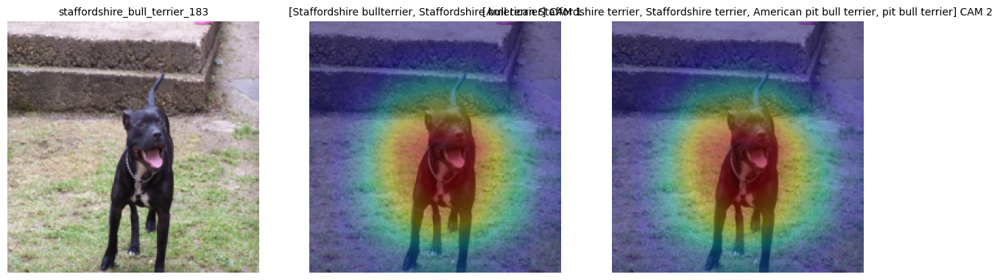

In [ ]:
# load and preprocess a random sample image
img_path5 = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))]
raw_img = Image.open(img_path5)
img_input = preprocess1(raw_img)
output = model(img_input.unsqueeze(0))
probs = F.softmax(output, dim=1)
class_idx, class_idx2 = map(int, (-probs).argsort()[0][:2])
feature_maps = feature_extraction(model, img_input.unsqueeze(0)).squeeze().detach().numpy()
activation_weights = list(model.parameters())[-2].data.numpy()
numpy_img = np.asarray(preprocess2(raw_img))
show_CAM(img_path5, numpy_img, feature_maps, activation_weights, classes, class_idx, class_idx2)

## [**Gradient-weighted CAM (Grad-CAM)**](https://arxiv.org/pdf/1610.02391.pdf)

*Overcoming limitation of CAM*
- Replacing the weights for the GAP of CAM by using gradients without GAP
- Generalized CAM

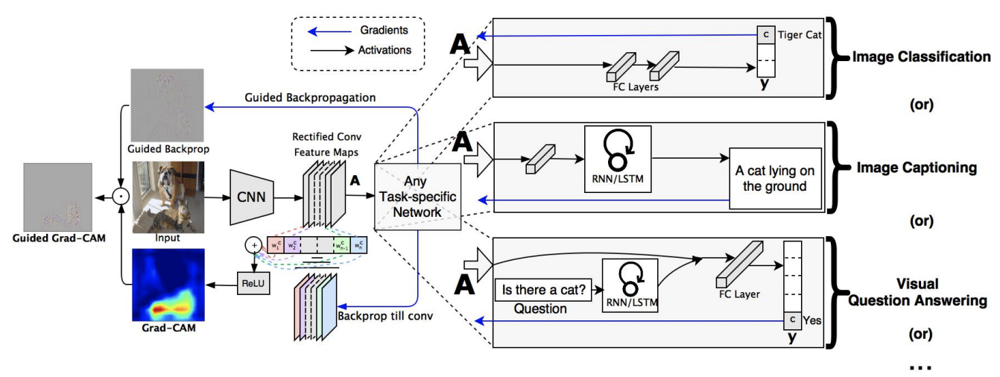

**Workflow**
1. input : image & class of interest (any type of differentiable output)
>$c$ : class of interest
2. forward propagation : CNN part + computing task-specific output score
>$A^k_{ij}$ : (i,j) component of k-th channel of rectified convolutional feature maps, (1 ≤ i ≤ u, 1 ≤ j ≤ v)  
>$y_c$ : score for class $c$
 - task : image classification, image captioning, visual question answering, ...
3. gradient set
 - class of interest : 1 / the rest : 0
4. backward propagation to rectified convolutional feature maps  
>$\cfrac{\partial y^c}{\partial A^k_{ij}}$ : (i,j) component of gradient  
$\alpha^c_k=\cfrac{1}{uv}\sum\limits_{i=1}^u\sum\limits_{j=1}^v\cfrac{\partial y^c}{\partial A^k_{ij}}$ : attribution of k-th channel of feature maps for class c (replacing the role of GAP)
 - computing coarse Grad-CAM localization  
 >>$L^c_{Grad-CAM}=ReLU(\sum\limits_k\alpha^c_kA^k)$  
 (localization : supporting features for class c)  
 $L^c_{Grad-CAM}=ReLU(-\sum\limits_k\alpha^c_kA^k)$  
 (localization : opposing features for class c ; counterfactual explanation)
 - heatmap accounting for particular decision
 - limitation of localization
5. Guided Grad-CAM : pixel-wise multiplication of upscaled Grad-CAM heatmap and [guided backpropagation](https://leslietj.github.io/2020/07/22/Deep-Learning-Guided-BackPropagation/)
 - high-resolution & concept-specific
 - better than only localization

※ computation of Grad-CAM  
>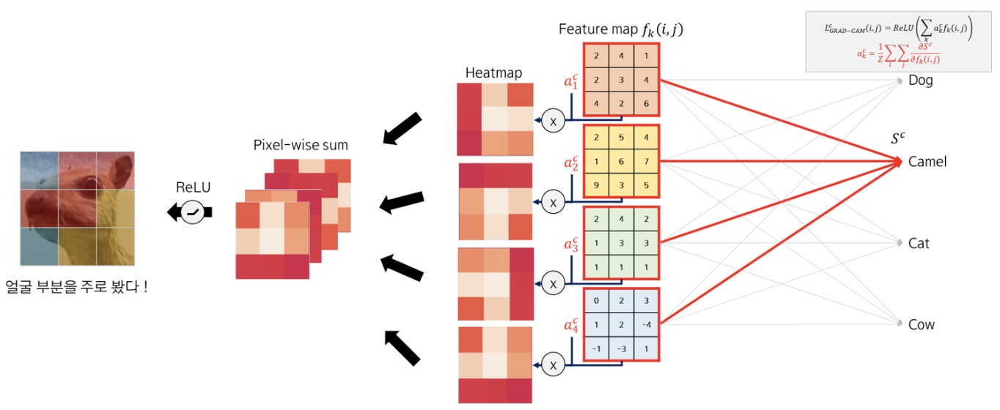

**Comparison**  
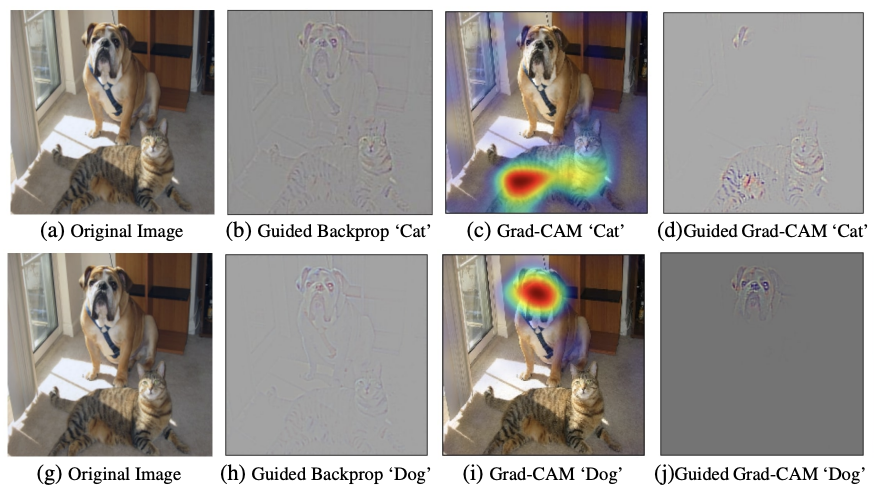

>$(b)\odot(c)=(d)\,,\,(h)\odot(i)=(j)$

**Benefits**

- <ins>robust to adversarial noise</ins>  
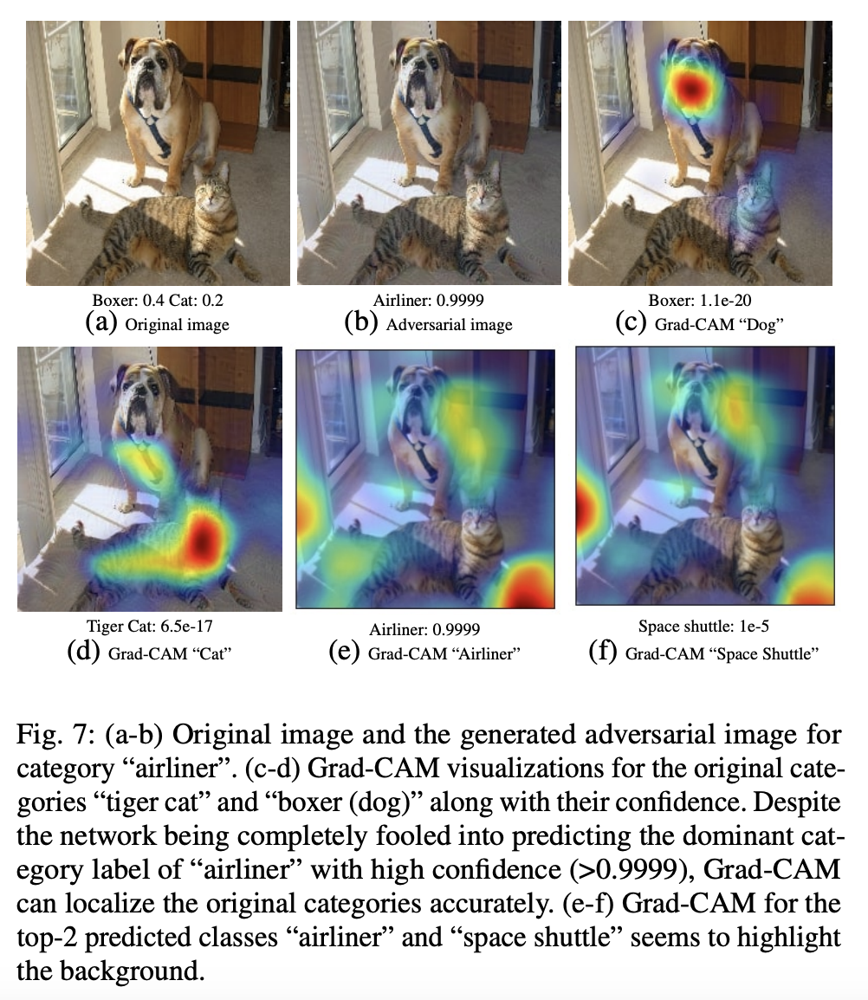

- <ins>identifying bias in dataset</ins> : detailed explanation for incorrect prediction reveals bias inherent in dataset

### 실습 코드

In [ ]:
import torch
import torch.nn as nn
import torchvision
from torchvision.datasets import OxfordIIITPet
from torchvision import models, transforms
import torch.nn.functional as F
from PIL import Image
from matplotlib import pyplot as plt
import urllib.request
import ast
import numpy as np
import os
import cv2
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# class of ImageNet
class_url = 'https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt'
with urllib.request.urlopen(class_url) as handler:
    data = handler.read().decode()
    classes = ast.literal_eval(data)

OxfordIIITPet(root='./', download=True)

# 파일 형식 제한
pet = os.listdir('/content/oxford-iiit-pet/images')
for x in pet:
    if not x.endswith('.jpg'):
        pet.remove(x)

# 전처리 정보 : ImageNet transform
# https://github.com/pytorch/examples/blob/42e5b996718797e45c46a25c55b031e6768f8440/imagenet/main.py#L89-L101
# 1. 예측 전처리
preprocess1 = transforms.Compose([
    # transforms.Resize(256), # 비율 맞춰서 이미지 규격 조정 ; 긴 모서리가 남을 수 있음 ; 비율 왜곡으로 인한 성능 저하를 더 예방 ; 예측에 사용할 이미지에 따라 적절히 다른 처리 필요
    # transforms.CenterCrop(224), # 중심 기준 정방형
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
# 2. 시각화 전처리 ; ToTensor, Normalize 제외
preprocess2 = transforms.Compose([
    # transforms.Resize(256),
    # transforms.CenterCrop(224)
    transforms.Resize((224,224))
])

# 샘플 이미지
img_path0 = '/content/oxford-iiit-pet/images/British_Shorthair_209.jpg'
# img_path = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))] : 랜덤 예시
# img_path`n` : CAM 실습 코드 예시 `n`과 비교
raw_img0 = Image.open(img_path0)
img_input0 = preprocess1(raw_img0) # 예측 용도
numpy_img0 = np.asarray(preprocess2(raw_img0)) # 시각화 용도
print(img_input0.shape)
print(numpy_img0.shape)

100%|██████████| 791918971/791918971 [00:26<00:00, 29668660.10it/s]


Extracting oxford-iiit-pet/images.tar.gz to oxford-iiit-pet


100%|██████████| 19173078/19173078 [00:01<00:00, 15088298.27it/s]


Extracting oxford-iiit-pet/annotations.tar.gz to oxford-iiit-pet
torch.Size([3, 224, 224])
(224, 224, 3)


- (참고)pretrained model 객체의 속성으로서 하위 구조의 이름을 확인


In [ ]:
model = models.resnet18(weights='DEFAULT')
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
# each child corresponds to a block or module in the model
for name, child in model.named_children():
    print(name)

conv1
bn1
relu
maxpool
layer1
layer2
layer3
layer4
avgpool
fc


In [ ]:
# names of all the modules, including sub-modules within the blocks
for name, module in model.named_modules():
    print(name)


conv1
bn1
relu
maxpool
layer1
layer1.0
layer1.0.conv1
layer1.0.bn1
layer1.0.relu
layer1.0.conv2
layer1.0.bn2
layer1.1
layer1.1.conv1
layer1.1.bn1
layer1.1.relu
layer1.1.conv2
layer1.1.bn2
layer2
layer2.0
layer2.0.conv1
layer2.0.bn1
layer2.0.relu
layer2.0.conv2
layer2.0.bn2
layer2.0.downsample
layer2.0.downsample.0
layer2.0.downsample.1
layer2.1
layer2.1.conv1
layer2.1.bn1
layer2.1.relu
layer2.1.conv2
layer2.1.bn2
layer3
layer3.0
layer3.0.conv1
layer3.0.bn1
layer3.0.relu
layer3.0.conv2
layer3.0.bn2
layer3.0.downsample
layer3.0.downsample.0
layer3.0.downsample.1
layer3.1
layer3.1.conv1
layer3.1.bn1
layer3.1.relu
layer3.1.conv2
layer3.1.bn2
layer4
layer4.0
layer4.0.conv1
layer4.0.bn1
layer4.0.relu
layer4.0.conv2
layer4.0.bn2
layer4.0.downsample
layer4.0.downsample.0
layer4.0.downsample.1
layer4.1
layer4.1.conv1
layer4.1.bn1
layer4.1.relu
layer4.1.conv2
layer4.1.bn2
avgpool
fc


>**resnet18**  
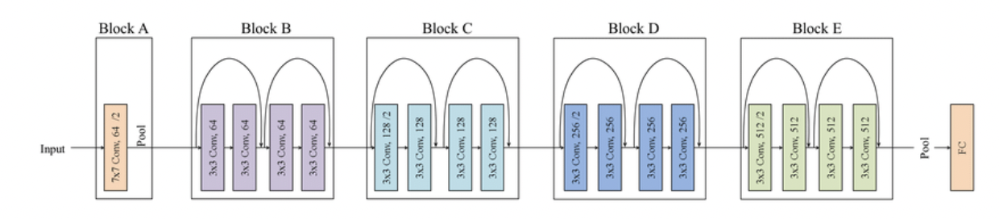

In [ ]:
# resnet18 구조 구체적 확인 예시
model = models.resnet18(weights='DEFAULT')
print(len(list(model.children())))
for name, child in model.named_children():
    print('\n')
    print(f'>>>{name}')
    print(child)

10


>>>conv1
Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)


>>>bn1
BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


>>>relu
ReLU(inplace=True)


>>>maxpool
MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)


>>>layer1
Sequential(
  (0): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (1): BasicBlock(
    (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv2): Conv2d(64, 64, k

In [ ]:
model.avgpool

AdaptiveAvgPool2d(output_size=(1, 1))

>**vgg19**  
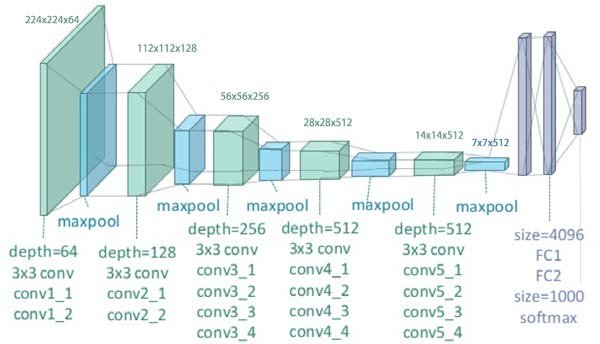

In [ ]:
# vgg19 구조 구체적 확인 예시
model = models.vgg19(weights='DEFAULT')
print(len(list(model.children())))
for name, child in model.named_children():
    print('\n')
    print(f'>>>{name}')
    print(child)

3


>>>features
Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True

In [ ]:
model.avgpool

AdaptiveAvgPool2d(output_size=(7, 7))

**Target Layer for computing CAM** ; well-known common target layer
- FasterRCNN: `model.backbone`
- Resnet18 & 50: `model.layer4[-1]`
- VGG & densenet161: `model.features[-1]`
- mnasnet1_0: `model.layers[-1]`
- ViT: `model.blocks[-1].norm1`
- SwinT: `model.layers[-1].blocks[-1].norm1`
- (unknown): list with several layers → averaged CAM

In [ ]:
# GradCAM(model_name) : 입력받은 model에서 Grad-CAM 구현에 필요한 기능을 함께 정의
class GradCAM(nn.Module):
    def __init__(self, model_name):
        super().__init__()
        if model_name=='resnet18':
            resnet = models.resnet18(weights='DEFAULT')
            self.encoder = nn.Sequential(*(list(resnet.children())[:-2]))
            self.pool = resnet.avgpool
            self.classifier = resnet.fc

        elif model_name=='vgg19':
            vgg = models.vgg19(weights='DEFAULT')
            self.encoder = vgg.features
            self.pool = vgg.avgpool
            self.classifier = vgg.classifier

        else:
            assert False, f'not implemented'

        self.gradients = None

    def gradients_hook(self, grad):
        self.gradients = grad

    def forward(self, x):
        x = self.encoder(x)
        x.register_hook(self.gradients_hook)
            # x.register_hook(f) : f(x.grad) invoked when the gradients of x are computed during backpropagation
        x = self.pool(x)
        x = x.flatten(start_dim=1) # start_dim=1 : 배치 차원 제외하고 classification의 Linear 레이어에 대한 입력 형식으로 변환
        x = self.classifier(x)
        return x

    def feature_extraction(self, x):
        return self.encoder(x)

In [ ]:
# 모델 이름과 이미지 경로 받아서 예측 후 coarse Grad-CAM과 예측 레이블 반환
def gradcam(model_name, img_path):
    raw_img = Image.open(img_path)
    img_input = preprocess1(raw_img).to(device).unsqueeze(dim=0)
    numpy_img = np.asarray(preprocess2(raw_img))

    model = GradCAM(model_name).to(device)
    model.eval()

    img_label = img_path[10:-5] if img_path.startswith('n') and img_path.endswith('.JPEG') else img_path[32:-4]
    result = []
    cls_label = []

    # top-1,2
    for t in range(2):
        pred = model(img_input)
        cls_idx = torch.argsort(-pred, dim=1)[0][t]
        cls_label.append(classes[cls_idx.item()])

        pred[:, cls_idx].backward()
        gradients = model.gradients.detach() # gradients : (1, 512, feat_h, feat_w)
        attr = torch.mean(gradients, dim=[0,2,3]) # attr : (512,)
            # attribution of k-th channel of feature maps for each top-t class measured by average pooling
        feature_map = model.feature_extraction(img_input).detach() # feature_map : (1, 512, feat_h, feat_w)
        # coarse Grad-CAM
        for i in range(512):
            feature_map[:,i,:,:] *= attr[i]
        heatmap = F.relu(torch.sum(feature_map, dim=1).squeeze()) # heatmap : (feat_h, feat_w)
        # heatmap = torch.sum(feature_map, dim=1).squeeze() # relu 제외
        # heatmap 생성
        heatmap -= heatmap.min()
        heatmap /= heatmap.max()
        heatmap = np.uint8(255 * heatmap.cpu().numpy()) # 0~255 정수로 변환
        # colormap 변환 ; cv2.resize 입력 순서는 (가로 W, 세로 H)
        heatmap = cv2.applyColorMap(cv2.resize(255-heatmap, (numpy_img.shape[1], numpy_img.shape[0])), cv2.COLORMAP_JET)
        # heatmap 적용
        result.append(np.uint8(numpy_img*0.5 + heatmap*0.3))

    return numpy_img, result, img_label, cls_label # 원본 이미지 시각화 용도, grad-cam 시각화 용도 top-1,2, 예측 레이블 top-1,2

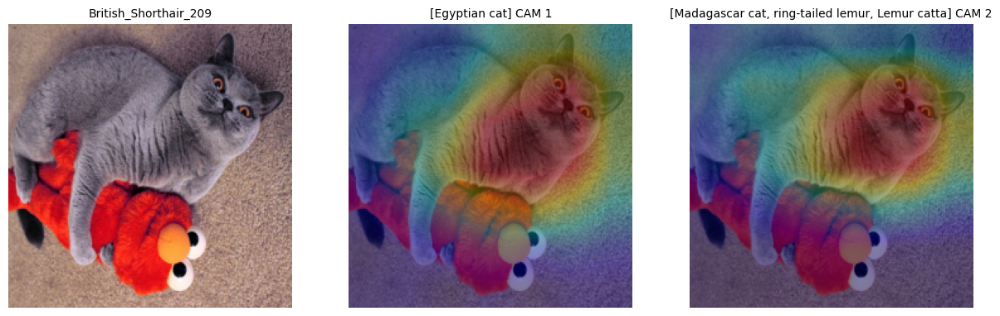

In [ ]:
def visualize_gradcam(numpy_img, result, img_label, cls_label):
    fig = plt.figure(figsize=(15, 5))
    # 원본 이미지
    ax1 = fig.add_subplot(1, 3, 1)
    ax1.imshow(numpy_img)
    ax1.set_title(img_label, fontsize=10)
    ax1.axis('off')
    # CAM 이미지 top-1
    ax2 = fig.add_subplot(1, 3, 2)
    ax2.imshow(result[0])
    ax2.set_title(f"[{cls_label[0]}] CAM 1", fontsize=10)
    ax2.axis('off')
    # CAM 이미지 top-2
    ax3 = fig.add_subplot(1, 3, 3)
    ax3.imshow(result[1])
    ax3.set_title(f"[{cls_label[1]}] CAM 2", fontsize=10)
    ax3.axis('off')

    plt.show()


img_path0 = '/content/oxford-iiit-pet/images/British_Shorthair_209.jpg'
# img_path = '/content/oxford-iiit-pet/images/' + pet[np.random.randint(0, len(pet))] : 랜덤 예시
# img_path`n` : CAM 실습 코드 예시 `n`과 비교 (1~5)

visualize_gradcam(*gradcam(model_name='resnet18', img_path=img_path0))

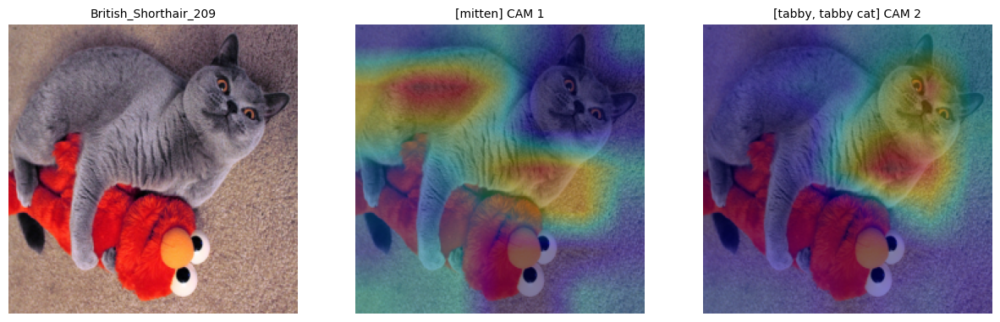

In [ ]:
visualize_gradcam(*gradcam(model_name='vgg19', img_path=img_path0))

#### 예시 1

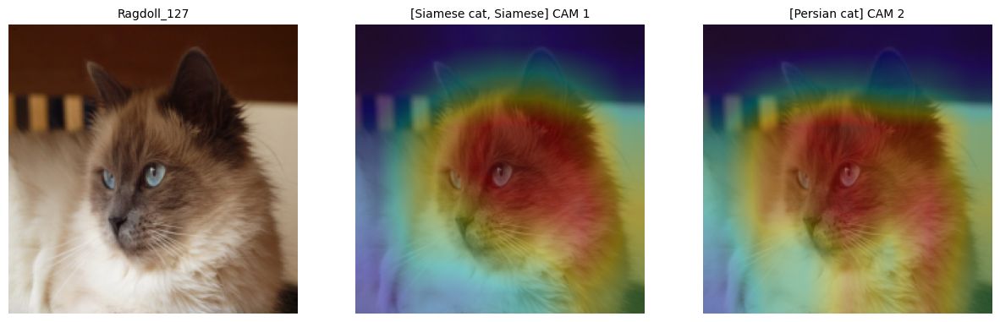

In [ ]:
visualize_gradcam(*gradcam(model_name='resnet18', img_path=img_path1))

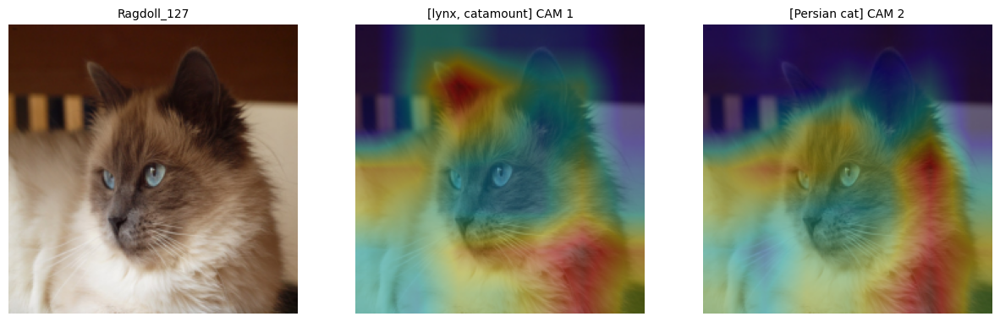

In [ ]:
visualize_gradcam(*gradcam(model_name='vgg19', img_path=img_path1))

#### 예시 2

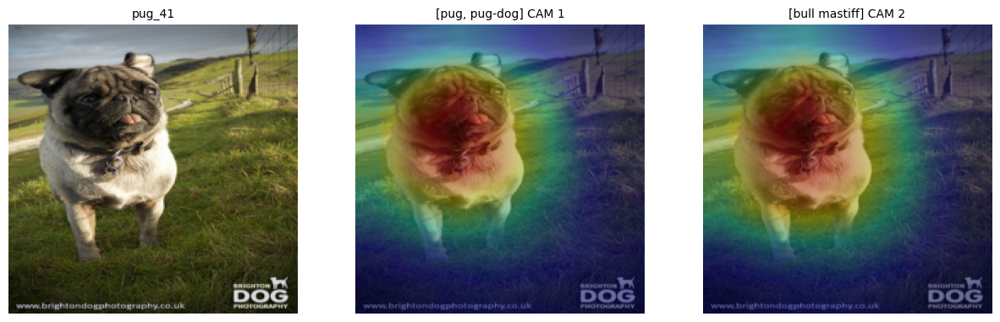

In [ ]:
visualize_gradcam(*gradcam(model_name='resnet18', img_path=img_path2))

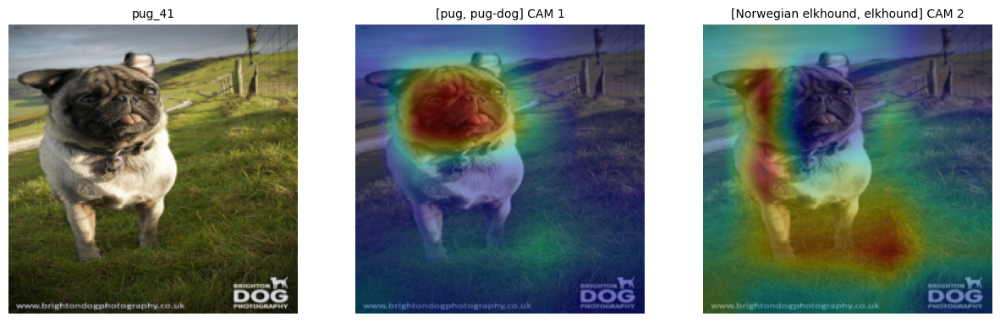

In [ ]:
visualize_gradcam(*gradcam(model_name='vgg19', img_path=img_path2))

#### 예시 3

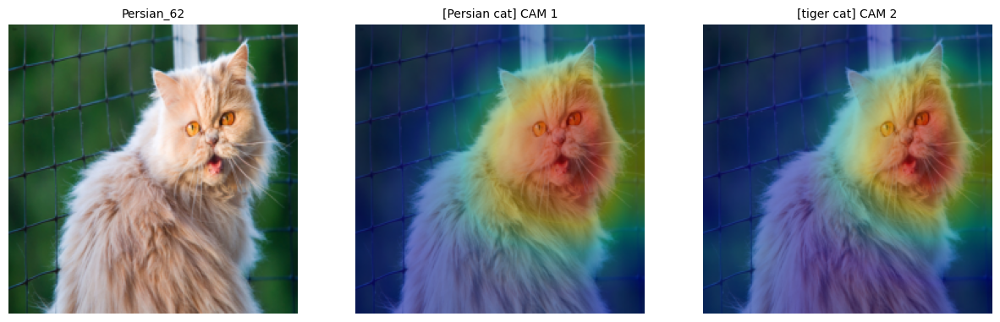

In [ ]:
visualize_gradcam(*gradcam(model_name='resnet18', img_path=img_path3))

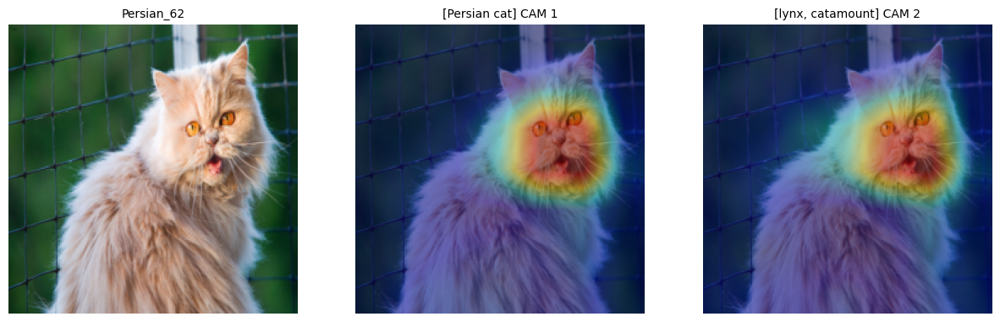

In [ ]:
visualize_gradcam(*gradcam(model_name='vgg19', img_path=img_path3))

#### 예시 4

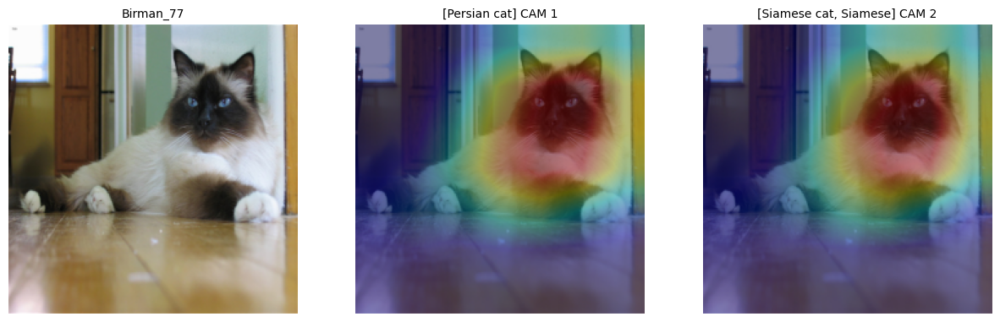

In [ ]:
visualize_gradcam(*gradcam(model_name='resnet18', img_path=img_path4))

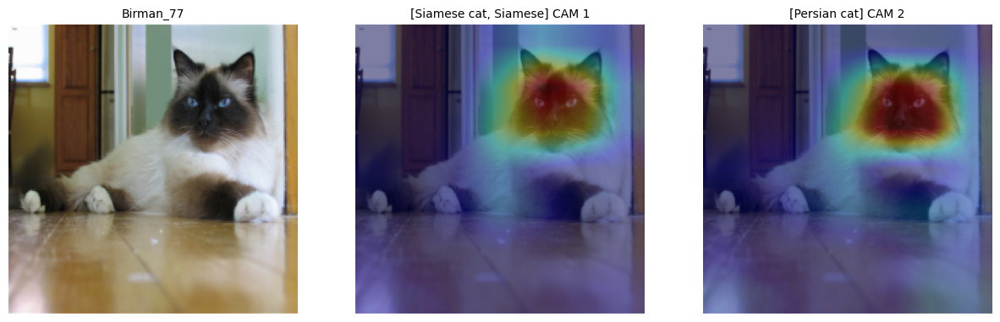

In [ ]:
visualize_gradcam(*gradcam(model_name='vgg19', img_path=img_path4))

#### 예시 5

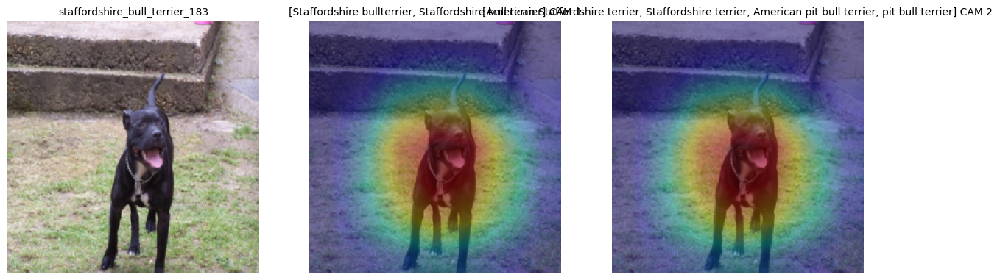

In [ ]:
visualize_gradcam(*gradcam(model_name='resnet18', img_path=img_path5))

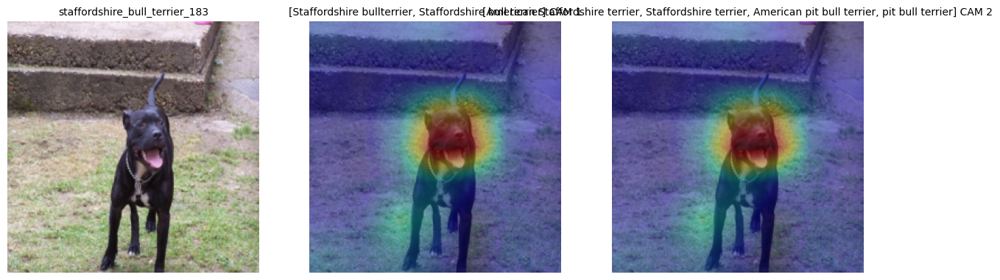

In [ ]:
visualize_gradcam(*gradcam(model_name='vgg19', img_path=img_path5))

#### 참고 구현 비교

In [ ]:
!git clone https://github.com/EliSchwartz/imagenet-sample-images.git
%cd /content/imagenet-sample-images/
path_list = ['n02504458_African_elephant.JPEG',
             'n02106662_German_shepherd.JPEG',
             'n01534433_junco.JPEG',
             'n04447861_toilet_seat.JPEG',
             'n04456115_torch.JPEG']
model_list = ['vgg19',
              'resnet18']

fatal: destination path 'imagenet-sample-images' already exists and is not an empty directory.
/content/imagenet-sample-images


------------------------------
vgg19
------------------------------


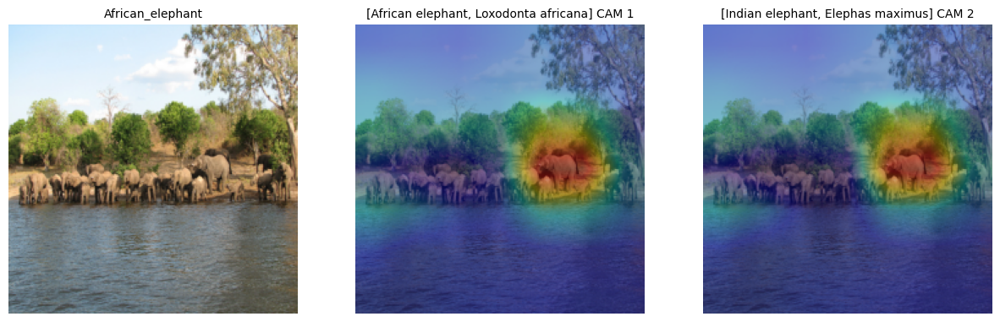

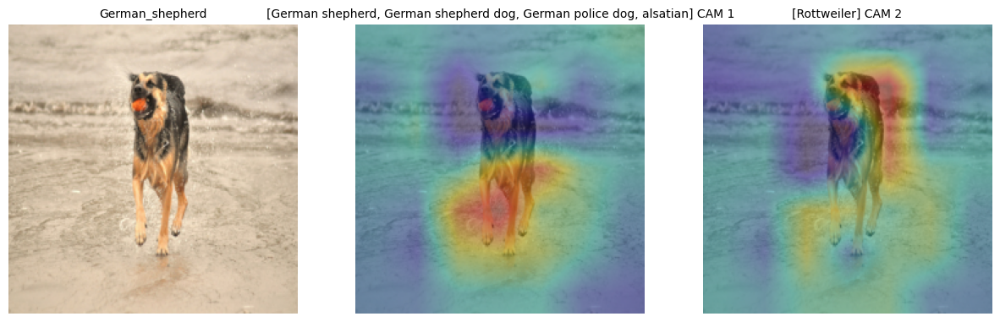

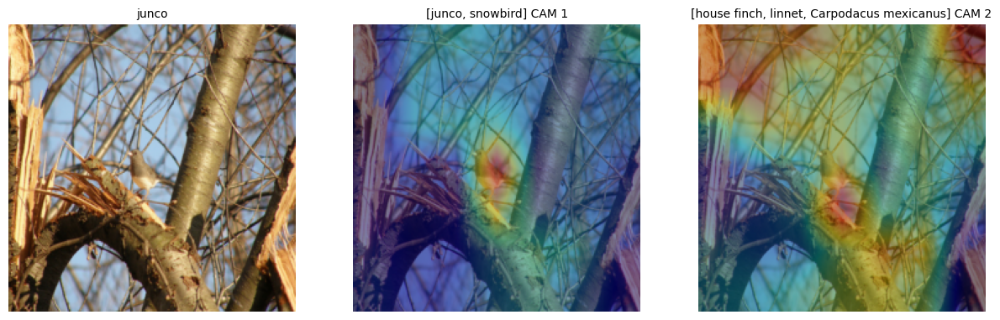

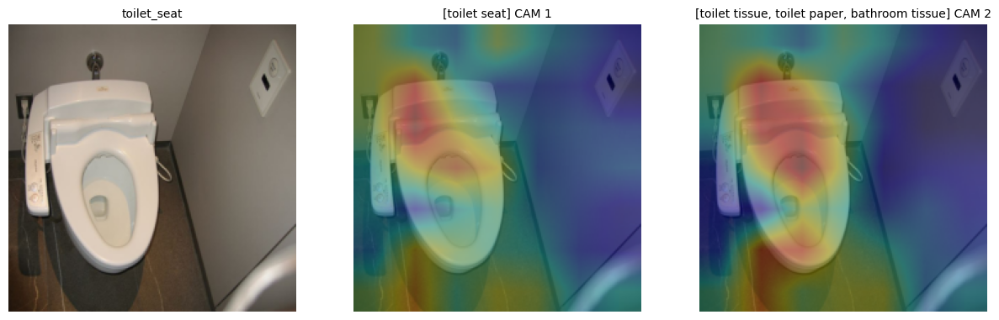

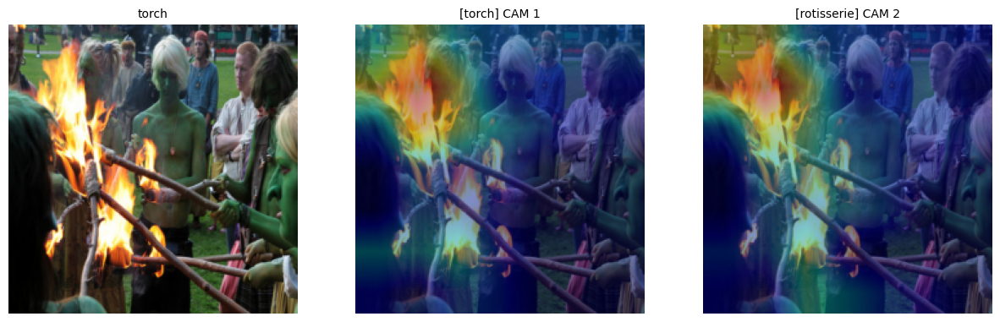

------------------------------
resnet18
------------------------------


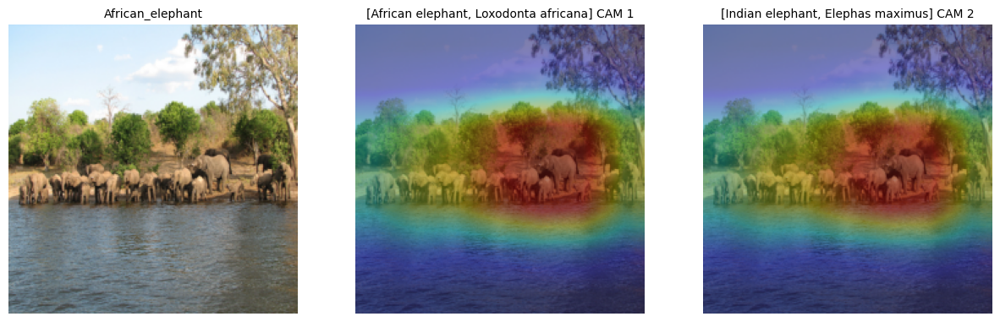

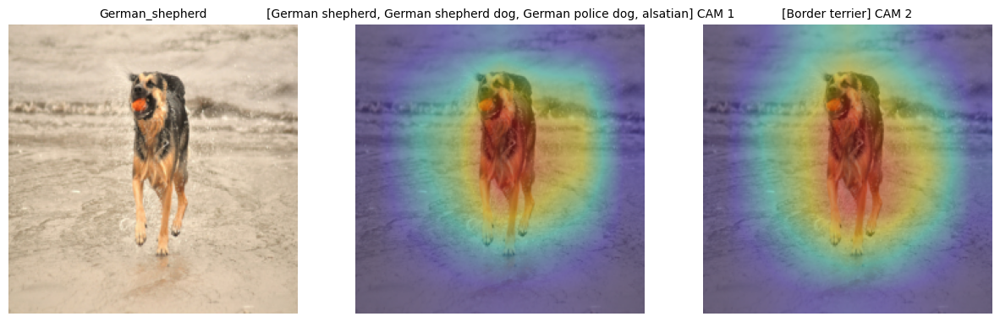

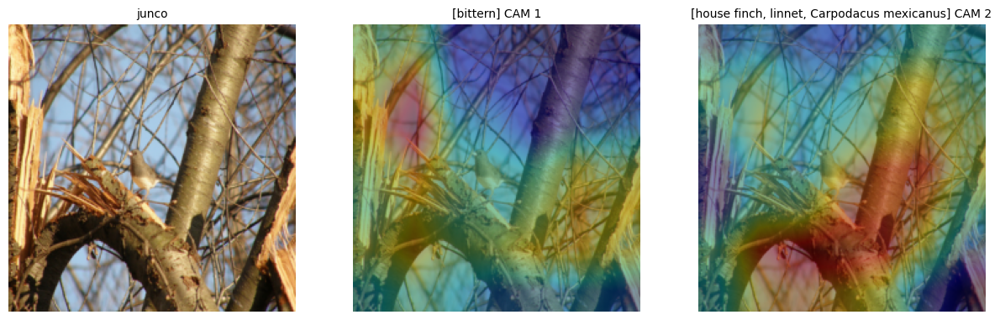

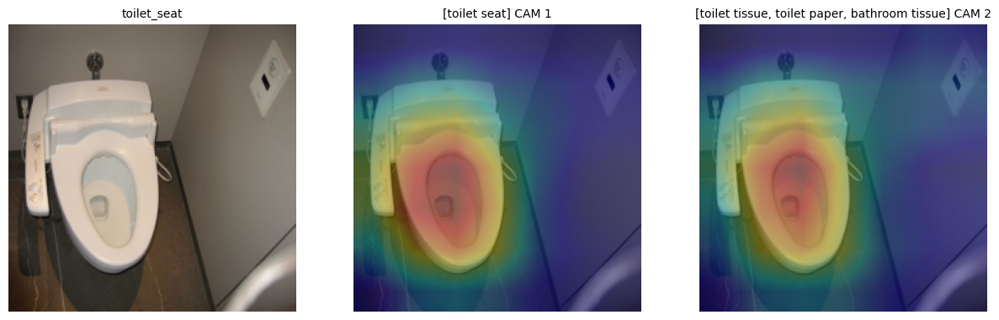

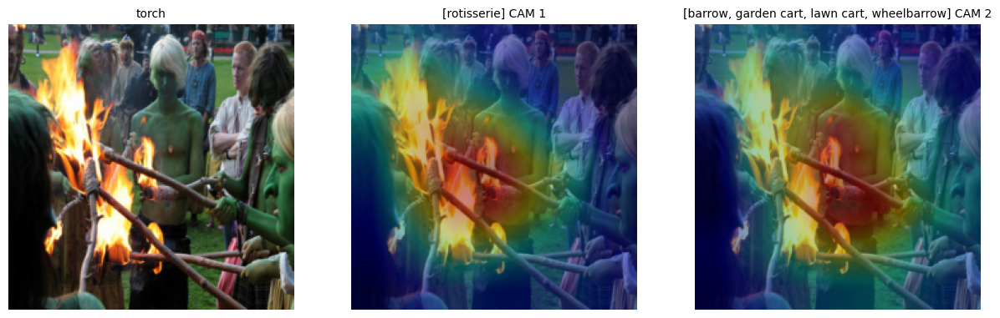

In [ ]:
for m in model_list:
    print('-'*30, m, '-'*30, sep='\n')
    for p in path_list:
        visualize_gradcam(*gradcam(model_name=m, img_path=p))

## [**Grad-CAM++**](https://arxiv.org/pdf/1710.11063.pdf)

- Grad-CAM using <ins>second order gradients

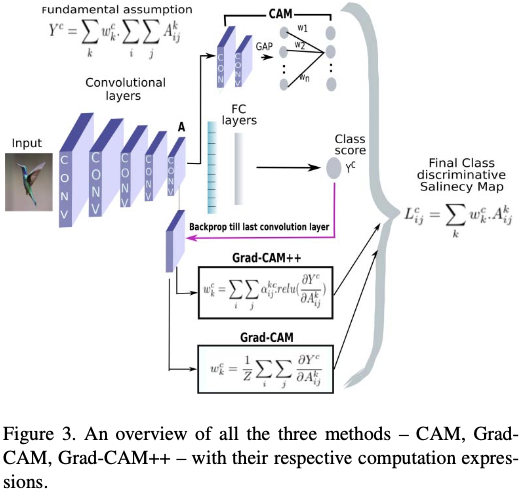

https://github.com/jacobgil/pytorch-grad-cam

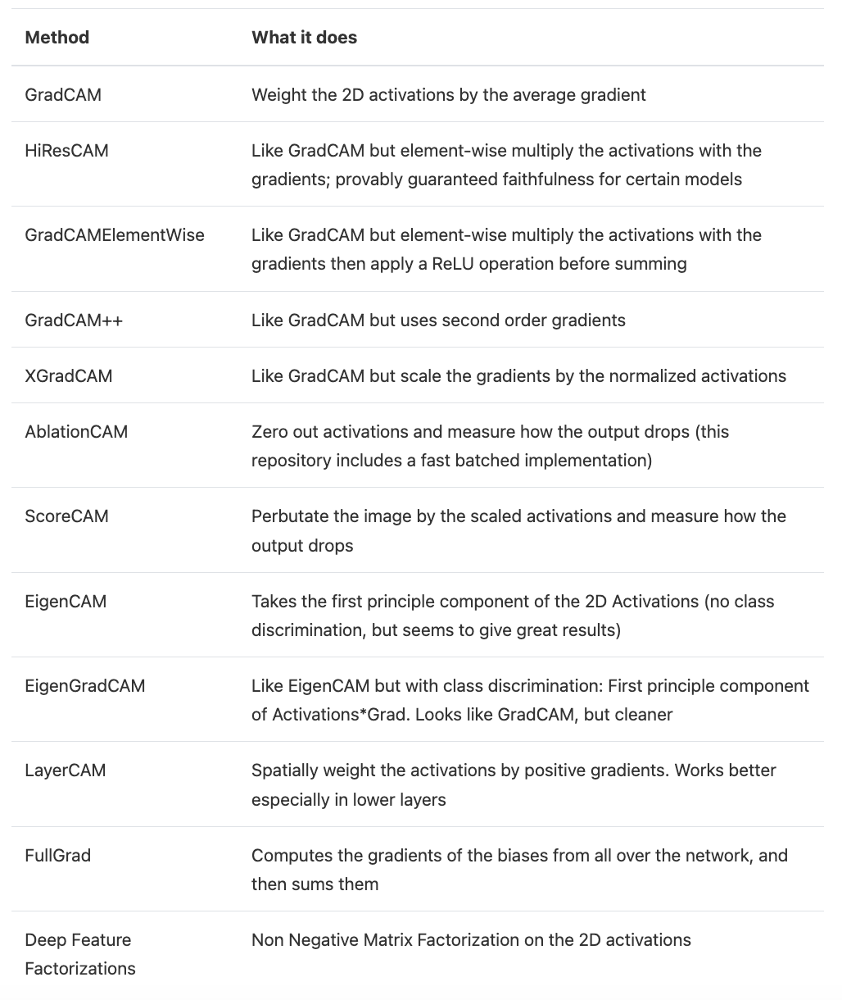